# **3. Interpretabilidad y feature_importance**

Ahora, usaremos los mejores modelos de cada seccion, y observamos el feature importance de cada uno, ejemplificandolo con diversos casos dentro de los datos estudiados.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from lime.lime_tabular import LimeTabularExplainer
import pickle

import joblib

## **3.1 XGBoost Hiperparametrizado**

Acto siguiente, vamos a observar cuales fueron las diez features mas importantes por modelo, de forma descendente.


In [ ]:
xgb_final = joblib.load("xgb_hp_best.pkl")

xgb_final


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['tenure',
                                                   'charges_monthly']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['gender', 'senior',
                                                   'partner', 'dependents',
                                                   'phone', 'phone_multiple',
                                                   'internet',
                                                   'internet_security',
                                                   'internet_backup',
                                                   'internet_protection',
                                                   'internet_support',
                                                   'streaming_tv',
                                                   'streaming_mov...
                               feature_types=None, gamma=1, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=5, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None, random_state=42, ...))])

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1175004313.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")


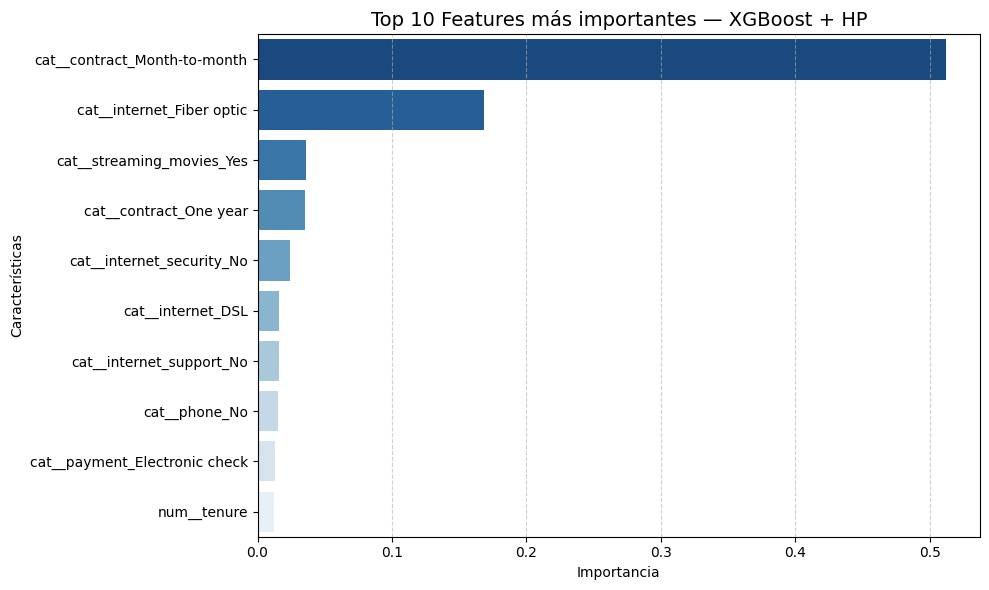

In [ ]:
xgb_model = list(xgb_final.named_steps.values())[-1] 
feature_names = xgb_final.named_steps["preprocessor"].get_feature_names_out()
importances = xgb_model.feature_importances_

feat_importance = (
    pd.DataFrame({"Feature": feature_names, "Importance": importances})
    .sort_values(by="Importance", ascending=False)
    .reset_index(drop=True)
)

top10 = feat_importance.head(10)

plt.figure(figsize=(10, 6))
sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")
plt.title("Top 10 Features más importantes — XGBoost + HP", fontsize=14)
plt.xlabel("Importancia")
plt.ylabel("Características")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

Aqui, los features mas importantes fueron:

- cat_contract_Month-to-month, cat_internet_Fiber optic, cat_streaming_movies_Yes, cat_contract_One year, cat_internet_security_no

### **3.1.1 Caso mixto de Churn (i=10)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #10 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = xgb_final.named_steps["preprocessor"]
classifier = xgb_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 10

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #10
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.342 | Sí: 0.658

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.308844
                          num__tenure > 0.92 -0.219157
                 num__charges_monthly > 0.83  0.108097
     0.00 < cat__internet_support_No <= 1.00  0.082618
    0.00 < cat__internet_Fiber optic <= 1.00  0.066119
           cat__internet_security_No <= 0.00 -0.058938
              cat__contract_One year <= 0.00 -0.051164
              cat__contract_Two year <= 0.00  0.047030
0.00 < cat__payment_Electronic check <= 1.00  0.045049
                  cat__dependents_No <= 0.00 -0.035897


In [ ]:
i = 10  
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3241674099.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


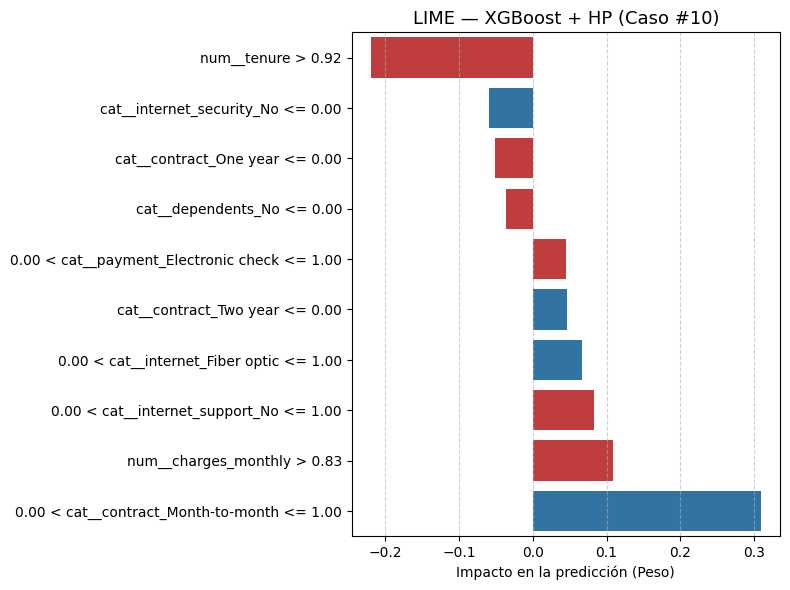

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — XGBoost + HP (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

🎨 Significado de los colores rojo y azul

En la gráfica que generamos:

🔴 Rojo → La característica empuja la predicción hacia la clase positiva (por ejemplo, “Sí churn”).

🔵 Azul → La característica empuja la predicción hacia la clase negativa (por ejemplo, “No churn”).

⚙️ Interpretación práctica (en tu contexto de churn)

Supongamos que el modelo predice si un cliente hará churn (“Sí”) o no (“No”).
Entonces:

Color	Significado	Ejemplo
🔴 Rojo	Contribuye a que el modelo prediga “Sí churn”	tenure bajo o MonthlyCharges alto hacen más probable que se vaya
🔵 Azul	Contribuye a que el modelo prediga “No churn”	tenure alto o contract tipo “two year” hacen menos probable que se vaya

### **3.1.2 Caso positivo de Churn (i=100)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #100 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = xgb_final.named_steps["preprocessor"]
classifier = xgb_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 100

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #100
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.057 | Sí: 0.943

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.308345
                 num__charges_monthly > 0.83  0.114031
     0.00 < cat__internet_support_No <= 1.00  0.080076
    0.00 < cat__internet_security_No <= 1.00  0.063614
    0.00 < cat__internet_Fiber optic <= 1.00  0.062803
                -0.96 < num__tenure <= -0.14  0.062403
              cat__contract_One year <= 0.00 -0.056287
0.00 < cat__payment_Electronic check <= 1.00  0.052427
              cat__contract_Two year <= 0.00  0.037556
             cat__internet_backup_No <= 0.00 -0.029726


In [ ]:
i = 100
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3241674099.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


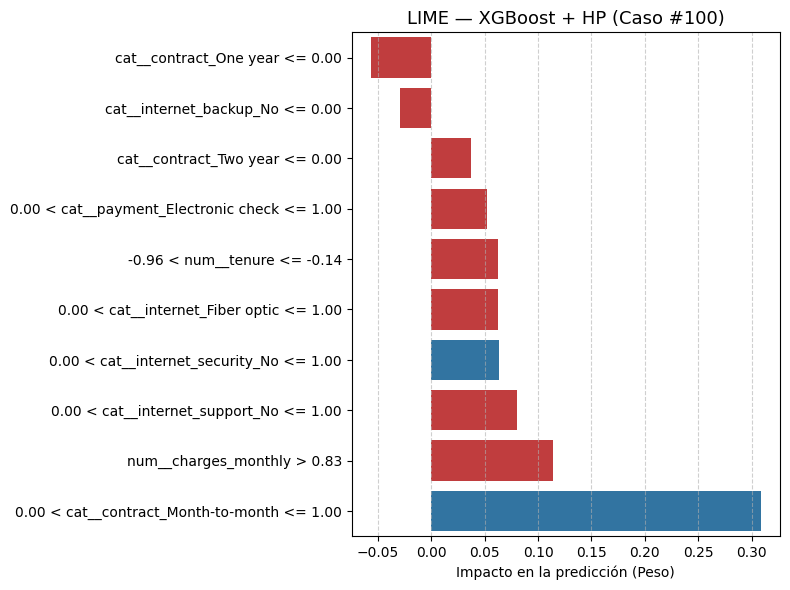

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — XGBoost + HP (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.1.3 Caso negativo de Churn (i=500)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #500 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = xgb_final.named_steps["preprocessor"]
classifier = xgb_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 500

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #500
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.950 | Sí: 0.050

Top 10 características más influyentes:
                       Característica      Peso
 cat__contract_Month-to-month <= 0.00 -0.306627
                   num__tenure > 0.92 -0.213865
     cat__internet_support_No <= 0.00 -0.088601
        num__charges_monthly <= -0.97 -0.078065
    cat__internet_Fiber optic <= 0.00 -0.061932
    cat__internet_security_No <= 0.00 -0.059241
       cat__contract_One year <= 0.00 -0.057930
cat__payment_Electronic check <= 0.00 -0.049070
        cat__contract_Two year > 0.00 -0.048957
      cat__internet_backup_No <= 0.00 -0.033199


In [ ]:
i = 500
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3241674099.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


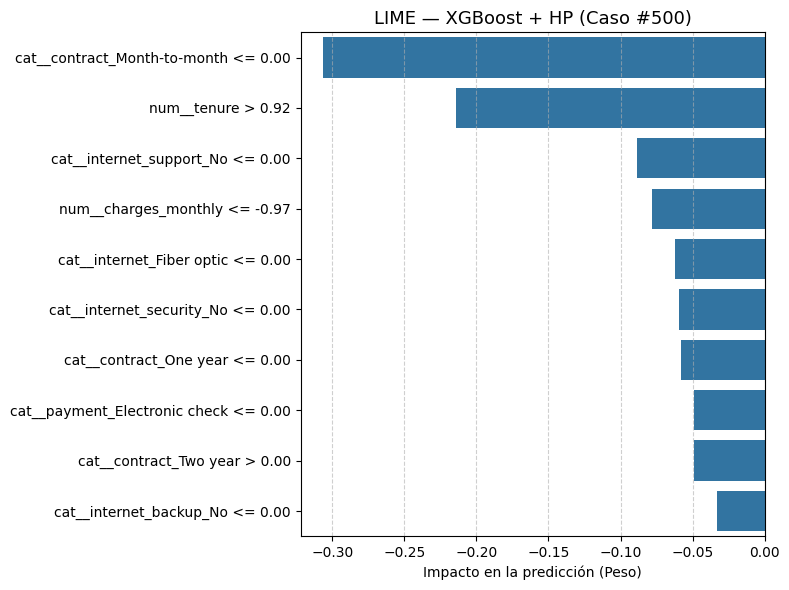

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — XGBoost + HP (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

## **3.2 LightGBM usando Hiperparametrizacion e is_unbalance=True (GPU)**

Acto siguiente, vamos a observar cuales fueron las diez features mas importantes por modelo, de forma descendente.


In [ ]:
lgb_final = joblib.load("lgb_hp_best.pkl")

lgb_final


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['tenure',
                                                   'charges_monthly']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['gender', 'senior',
                                                   'partner', 'dependents',
                                                   'phone', 'phone_multiple',
                                                   'internet',
                                                   'internet_security',
                                                   'internet_backup',
                                                   'internet_protection',
                                                   'internet_support',
                                                   'streaming_tv',
                                                   'streaming_movies',
                                                   'contract', 'paperless',
                                                   'payment'])])),
                ('clf',
                 LGBMClassifier(device='gpu', is_unbalance=True, max_bin=255,
                                min_child_samples=50, random_state=42,
                                reg_alpha=0, reg_lambda=0.5, subsample=0.8))])

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\2406429536.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")


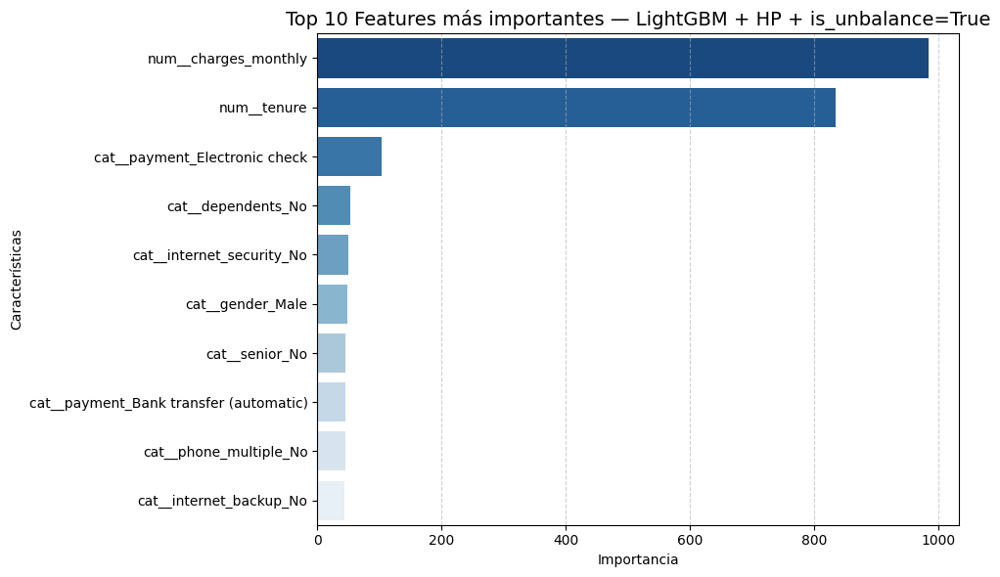

In [ ]:
lgb_model = list(lgb_final.named_steps.values())[-1] 
feature_names = lgb_final.named_steps["preprocessor"].get_feature_names_out()
importances = lgb_model.feature_importances_

feat_importance = (
    pd.DataFrame({"Feature": feature_names, "Importance": importances})
    .sort_values(by="Importance", ascending=False)
    .reset_index(drop=True)
)


top10 = feat_importance.head(10)


plt.figure(figsize=(10, 6))
sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")
plt.title("Top 10 Features más importantes — LightGBM + HP + is_unbalance=True", fontsize=14)
plt.xlabel("Importancia")
plt.ylabel("Características")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


Aqui, los features mas importantes fueron:

- num_charges_monthly, num_tenure, cat_payment_Electronic check, cat_dependents_no, cat_internet_security_no

### **3.2.1 Caso mixto de Churn (i=10)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #10 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = lgb_final.named_steps["preprocessor"]
classifier = lgb_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 10

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #10
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.489 | Sí: 0.511

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.211945
                          num__tenure > 0.92 -0.178962
                 num__charges_monthly > 0.83  0.117772
              cat__contract_Two year <= 0.00  0.091441
    0.00 < cat__internet_Fiber optic <= 1.00  0.084710
           cat__internet_security_No <= 0.00 -0.065589
0.00 < cat__payment_Electronic check <= 1.00  0.055556
     0.00 < cat__internet_support_No <= 1.00  0.051176
           cat__payment_Mailed check <= 0.00  0.029493
              cat__phone_multiple_No <= 0.00  0.028504


c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


In [ ]:
i = 10  
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\2846921519.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


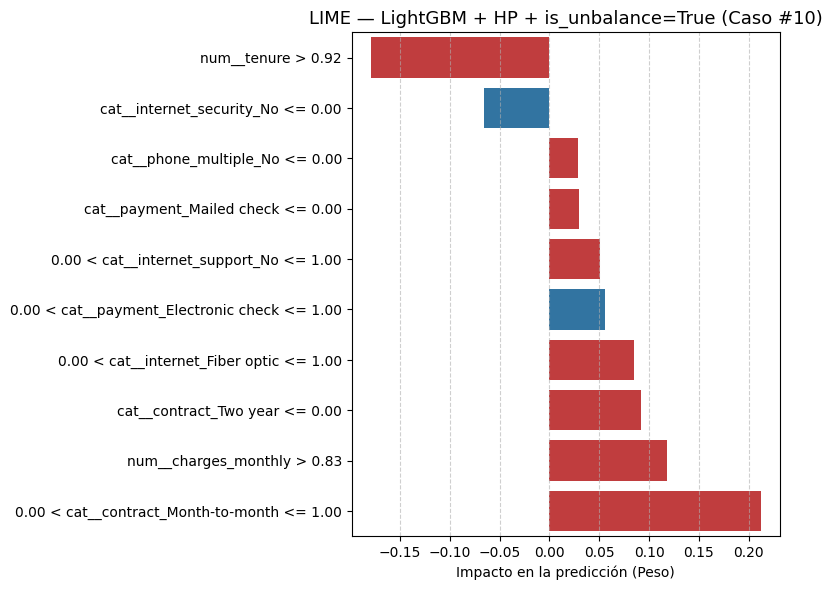

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — LightGBM + HP + is_unbalance=True (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.2.2 Caso positivo de Churn (i=100)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #100 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = lgb_final.named_steps["preprocessor"]
classifier = lgb_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 100

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #100
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.092 | Sí: 0.908

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.214130
                 num__charges_monthly > 0.83  0.115655
              cat__contract_Two year <= 0.00  0.102290
    0.00 < cat__internet_Fiber optic <= 1.00  0.074868
    0.00 < cat__internet_security_No <= 1.00  0.056041
     0.00 < cat__internet_support_No <= 1.00  0.053031
0.00 < cat__payment_Electronic check <= 1.00  0.050408
                -0.96 < num__tenure <= -0.14  0.038837
              cat__contract_One year <= 0.00 -0.036699
           0.00 < cat__dependents_No <= 1.00  0.027543


c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


In [ ]:
i = 100
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\2846921519.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


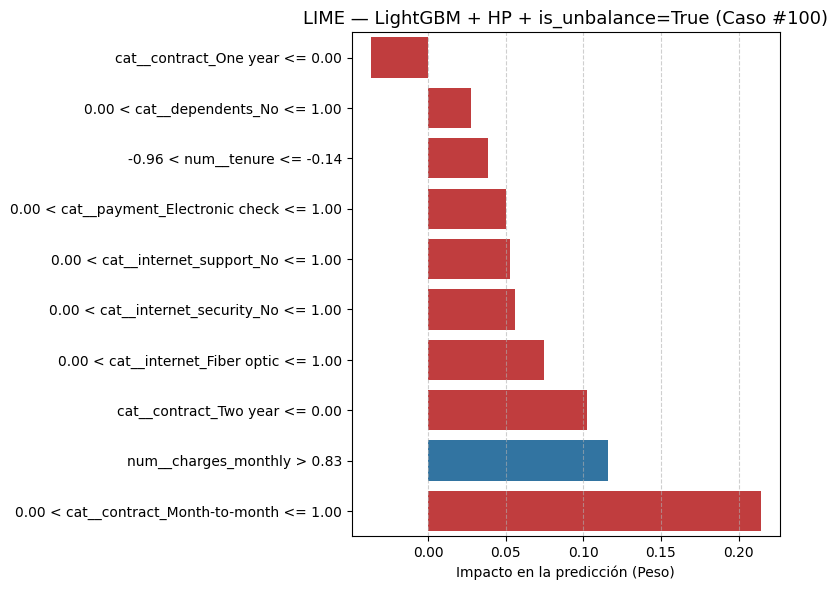

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — LightGBM + HP + is_unbalance=True (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.2.3 Caso negativo de Churn (i=500)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #500 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = lgb_final.named_steps["preprocessor"]
classifier = lgb_final.named_steps["clf"]


X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 500

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #500
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.904 | Sí: 0.096

Top 10 características más influyentes:
                       Característica      Peso
 cat__contract_Month-to-month <= 0.00 -0.209840
                   num__tenure > 0.92 -0.164397
        cat__contract_Two year > 0.00 -0.095385
    cat__internet_Fiber optic <= 0.00 -0.082338
    cat__internet_security_No <= 0.00 -0.064800
cat__payment_Electronic check <= 0.00 -0.055262
        num__charges_monthly <= -0.97 -0.054454
     cat__internet_support_No <= 0.00 -0.053411
       cat__contract_One year <= 0.00 -0.034037
    0.00 < cat__paperless_Yes <= 1.00  0.033337


c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
c:\Users\taran\miniconda3\envs\gpu_venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


In [ ]:
i = 500
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\2846921519.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


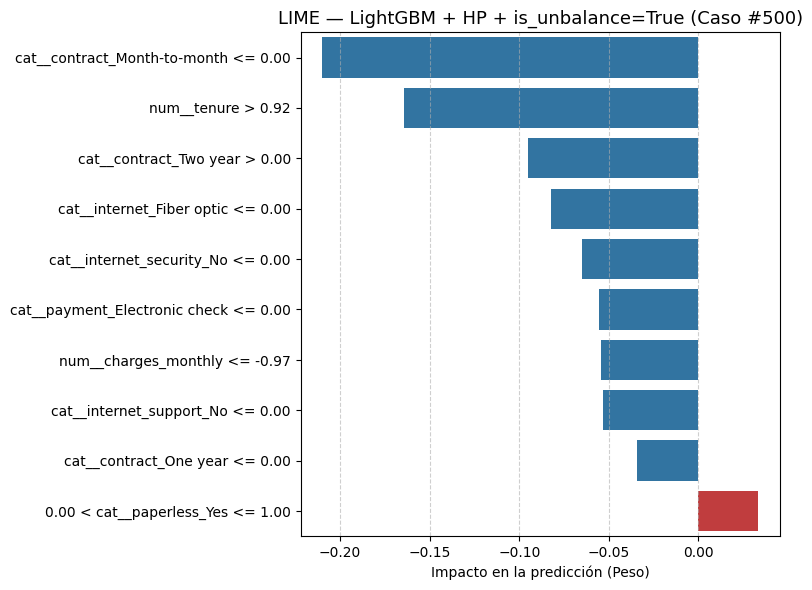

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — LightGBM + HP + is_unbalance=True (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

## **3.3 RandomForest usando Hiperparametrizacion y SMOTE (GPU)**

Acto siguiente, vamos a observar cuales fueron las diez features mas importantes por modelo, de forma descendente.


In [ ]:
rf_final = joblib.load("rf_smote_best.pkl")

rf_final


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['tenure',
                                                   'charges_monthly']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['gender', 'senior',
                                                   'partner', 'dependents',
                                                   'phone', 'phone_multiple',
                                                   'internet',
                                                   'internet_security',
                                                   'internet_backup',
                                                   'internet_protection',
                                                   'internet_support',
                                                   'streaming_tv',
                                                   'streaming_movies',
                                                   'contract', 'paperless',
                                                   'payment'])])),
                ('smote', SMOTE(random_state=42)),
                ('clf',
                 RandomForestClassifier(max_features='log2', min_samples_leaf=4,
                                        random_state=42))])

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1322585804.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")


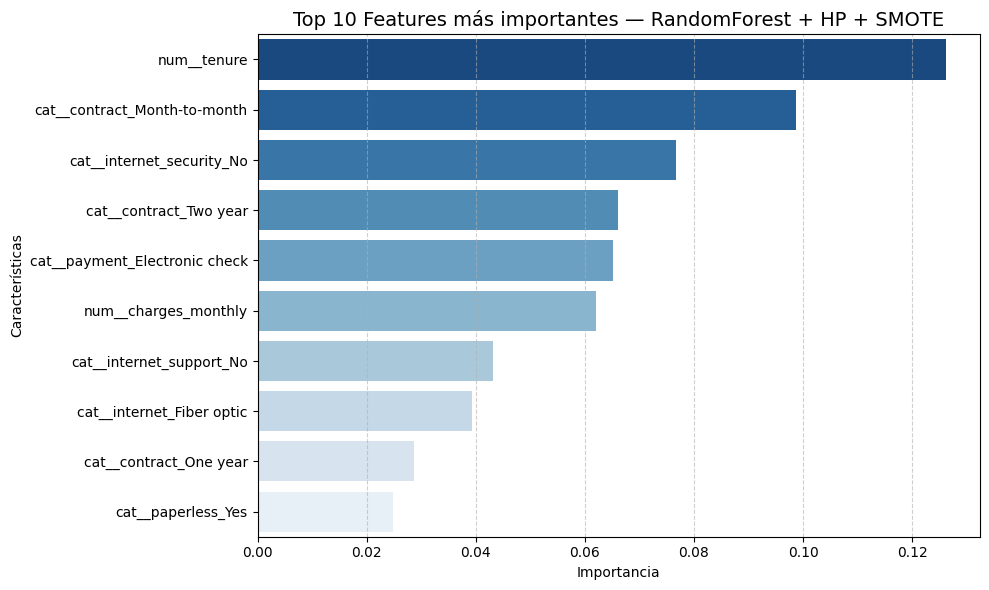

In [ ]:
rf_model = list(rf_final.named_steps.values())[-1] 
feature_names = rf_final.named_steps["preprocessor"].get_feature_names_out()
importances = rf_model.feature_importances_

feat_importance = (
    pd.DataFrame({"Feature": feature_names, "Importance": importances})
    .sort_values(by="Importance", ascending=False)
    .reset_index(drop=True)
)

top10 = feat_importance.head(10)


plt.figure(figsize=(10, 6))
sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")
plt.title("Top 10 Features más importantes — RandomForest + HP + SMOTE", fontsize=14)
plt.xlabel("Importancia")
plt.ylabel("Características")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


Aqui, los features mas importantes fueron:

- num_tenure, cat_contract_Month-to-month, cat_internet_security_no, cat_contract_Two year, y cat_payment_Electronic check

### **3.3.1 Caso mixto de Churn (i=10)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #10 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = rf_final.named_steps["preprocessor"]
classifier = rf_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 10

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #10
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.784 | Sí: 0.216

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.125976
              cat__contract_Two year <= 0.00  0.112032
                          num__tenure > 0.92 -0.065256
    0.00 < cat__internet_Fiber optic <= 1.00  0.055367
           cat__internet_security_No <= 0.00 -0.049559
     0.00 < cat__internet_support_No <= 1.00  0.039823
              cat__contract_One year <= 0.00  0.037018
0.00 < cat__payment_Electronic check <= 1.00  0.036081
                   cat__internet_DSL <= 0.00  0.029111
             cat__internet_backup_No <= 0.00 -0.025897


In [ ]:
i = 10  
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1000242734.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


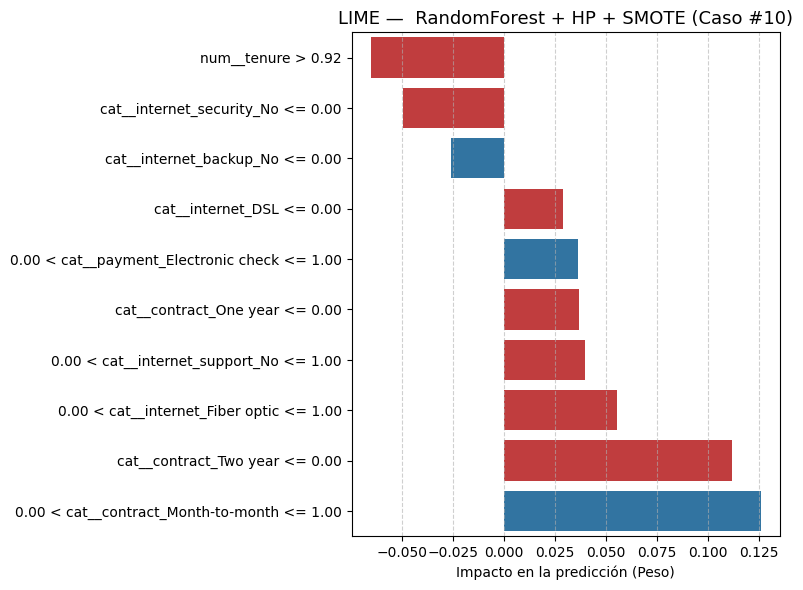

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME —  RandomForest + HP + SMOTE (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.3.2 Caso positivo de Churn (i=100)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #100 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = rf_final.named_steps["preprocessor"]
classifier = rf_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 100

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #100
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.104 | Sí: 0.896

Top 10 características más influyentes:
                              Característica      Peso
 0.00 < cat__contract_Month-to-month <= 1.00  0.127851
              cat__contract_Two year <= 0.00  0.107441
    0.00 < cat__internet_Fiber optic <= 1.00  0.057844
    0.00 < cat__internet_security_No <= 1.00  0.050673
     0.00 < cat__internet_support_No <= 1.00  0.039019
              cat__contract_One year <= 0.00  0.037405
0.00 < cat__payment_Electronic check <= 1.00  0.029534
                 num__charges_monthly > 0.83  0.025748
                   cat__internet_DSL <= 0.00  0.025092
             cat__internet_backup_No <= 0.00 -0.022727


In [ ]:
i = 100
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1000242734.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


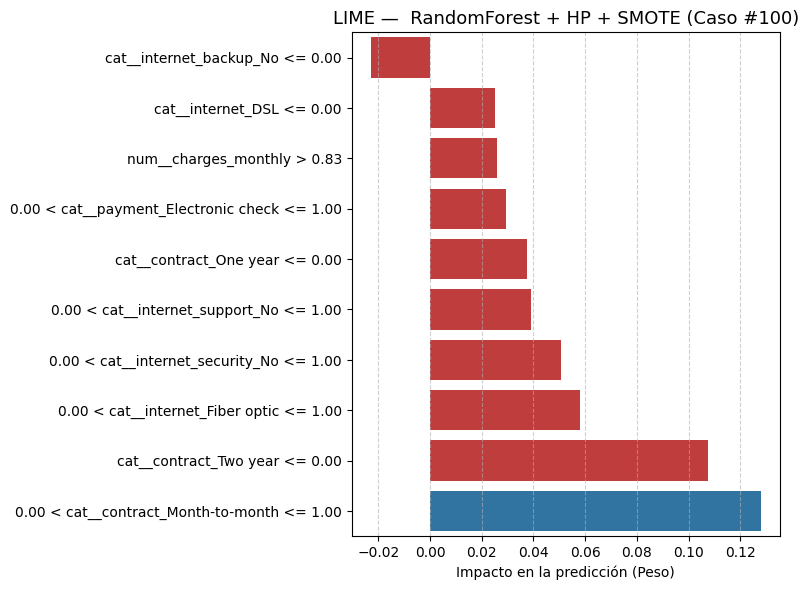

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME —  RandomForest + HP + SMOTE (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.3.3 Caso negativo de Churn (i=500)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #500 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = rf_final.named_steps["preprocessor"]
classifier = rf_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 500

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #500
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.953 | Sí: 0.047

Top 10 características más influyentes:
                       Característica      Peso
 cat__contract_Month-to-month <= 0.00 -0.121935
        cat__contract_Two year > 0.00 -0.111966
                   num__tenure > 0.92 -0.067853
    cat__internet_Fiber optic <= 0.00 -0.055226
    cat__internet_security_No <= 0.00 -0.047913
     cat__internet_support_No <= 0.00 -0.039761
       cat__contract_One year <= 0.00  0.034803
cat__payment_Electronic check <= 0.00 -0.028197
            cat__internet_DSL <= 0.00  0.027670
    0.00 < cat__paperless_Yes <= 1.00  0.023012


In [ ]:
i = 500
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1450505222.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


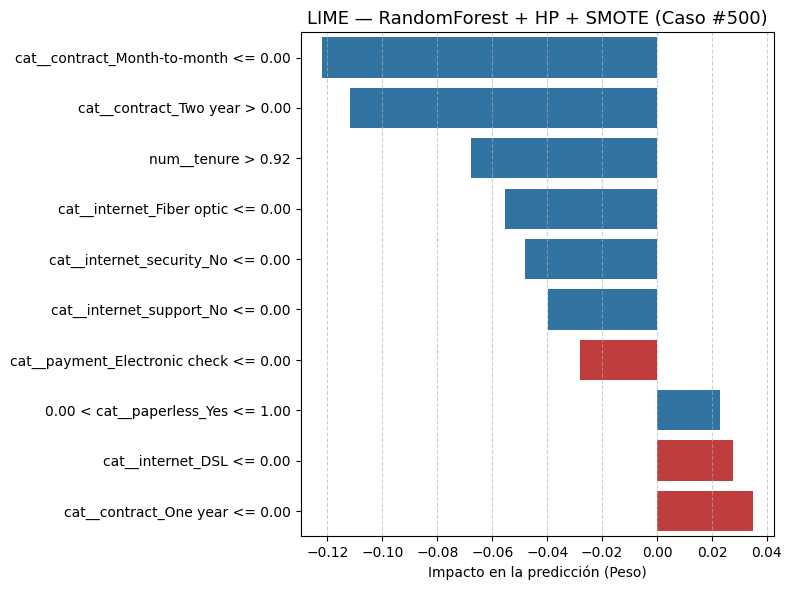

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — RandomForest + HP + SMOTE (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

## **3.4 CatBoost Hiperparametrizado**

Aqui, vamos a primero cargar el modelo.

In [ ]:
cat_final = joblib.load("cat_hp_best.pkl")

cat_final

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['tenure',
                                                   'charges_monthly']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['gender', 'senior',
                                                   'partner', 'dependents',
                                                   'phone', 'phone_multiple',
                                                   'internet',
                                                   'internet_security',
                                                   'internet_backup',
                                                   'internet_protection',
                                                   'internet_support',
                                                   'streaming_tv',
                                                   'streaming_movies',
                                                   'contract', 'paperless',
                                                   'payment'])])),
                ('clf',
                 <catboost.core.CatBoostClassifier object at 0x00000233BEA691F0>)])

Acto siguiente, vamos a observar cuales fueron las diez features mas importantes por modelo, de forma descendente.



C:\Users\taran\AppData\Local\Temp\ipykernel_19104\777005001.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")


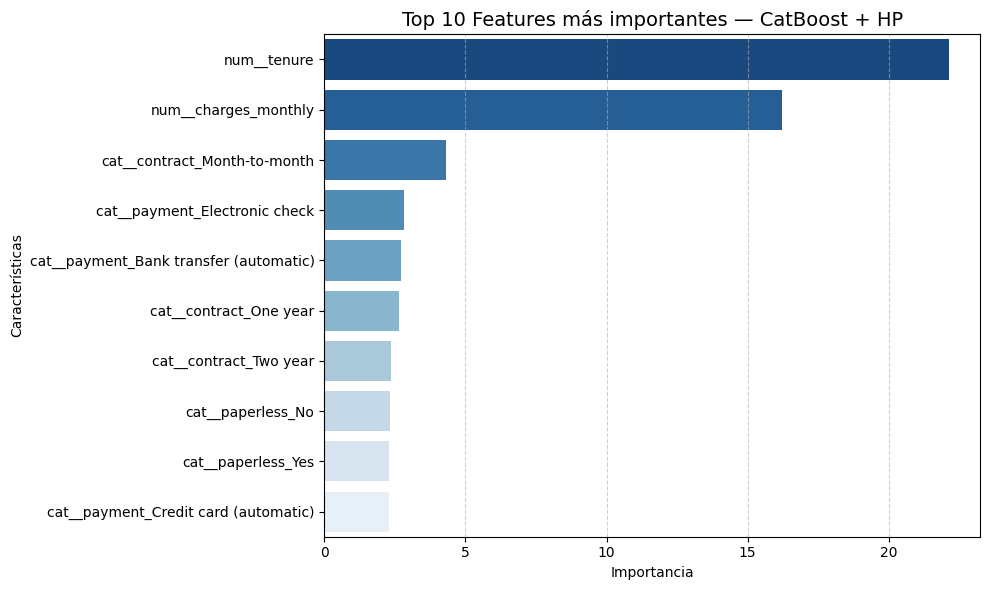

In [ ]:
cat_model = list(cat_final.named_steps.values())[-1] 
feature_names = cat_final.named_steps["preprocessor"].get_feature_names_out()
importances = cat_model.feature_importances_

feat_importance = (
    pd.DataFrame({"Feature": feature_names, "Importance": importances})
    .sort_values(by="Importance", ascending=False)
    .reset_index(drop=True)
)


top10 = feat_importance.head(10)

plt.figure(figsize=(10, 6))
sns.barplot(data=top10, x="Importance", y="Feature", palette="Blues_r")
plt.title("Top 10 Features más importantes — CatBoost + HP", fontsize=14)
plt.xlabel("Importancia")
plt.ylabel("Características")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


Aqui, los features mas importantes fueron:

- num_tenure, num_charges_monthly, cat_contract_Month-to-month, cat_payment_Electronic check y cat_payment_Back transfor (automatic)

### **3.3.1 Caso mixto de Churn (i=10)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #10 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = cat_final.named_steps["preprocessor"]
classifier = cat_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 10

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #10
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.894 | Sí: 0.106

Top 10 características más influyentes:
                             Característica      Peso
                         num__tenure > 0.92 -0.145752
0.00 < cat__contract_Month-to-month <= 1.00  0.110127
             cat__contract_Two year <= 0.00  0.076354
   0.00 < cat__internet_Fiber optic <= 1.00  0.071606
                num__charges_monthly > 0.83  0.049091
    0.00 < cat__internet_support_No <= 1.00  0.037021
          cat__internet_security_No <= 0.00 -0.031489
  0.00 < cat__internet_security_Yes <= 1.00 -0.025109
             cat__phone_multiple_No <= 0.00  0.023661
                  cat__paperless_No <= 0.00  0.022551


In [ ]:
i = 10  
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\925539086.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


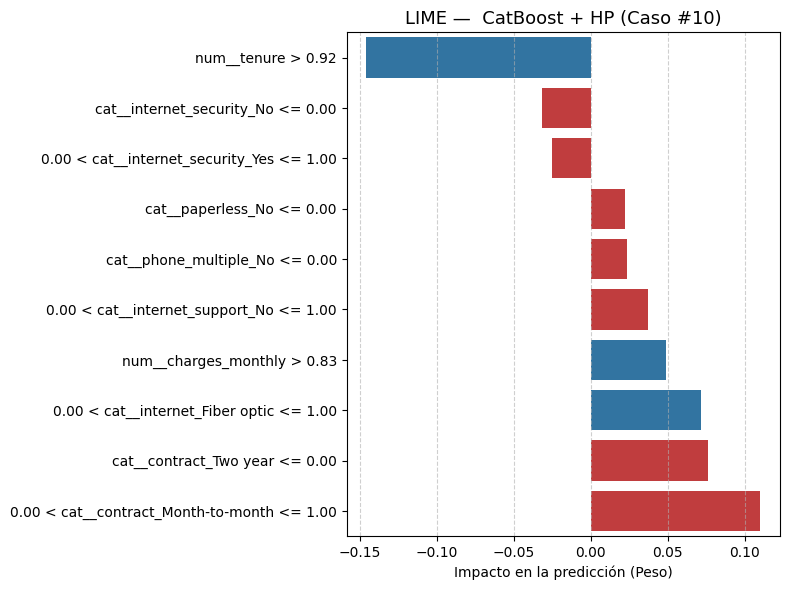

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME —  CatBoost + HP (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.3.2 Caso positivo de Churn (i=100)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #100 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = cat_final.named_steps["preprocessor"]
classifier = cat_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 100

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #100
--------------------------------------------------------------------------------
Clase predicha: Sí Churn 
Probabilidades -> No: 0.242 | Sí: 0.758

Top 10 características más influyentes:
                             Característica     Peso
0.00 < cat__contract_Month-to-month <= 1.00 0.103377
             cat__contract_Two year <= 0.00 0.081688
   0.00 < cat__internet_Fiber optic <= 1.00 0.072533
                num__charges_monthly > 0.83 0.057876
    0.00 < cat__internet_support_No <= 1.00 0.039615
   0.00 < cat__internet_security_No <= 1.00 0.034392
             cat__phone_multiple_No <= 0.00 0.030209
                  cat__paperless_No <= 0.00 0.025841
             cat__contract_One year <= 0.00 0.024152
                     cat__senior_Yes > 0.00 0.022402


In [ ]:
i = 100
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\1968648908.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


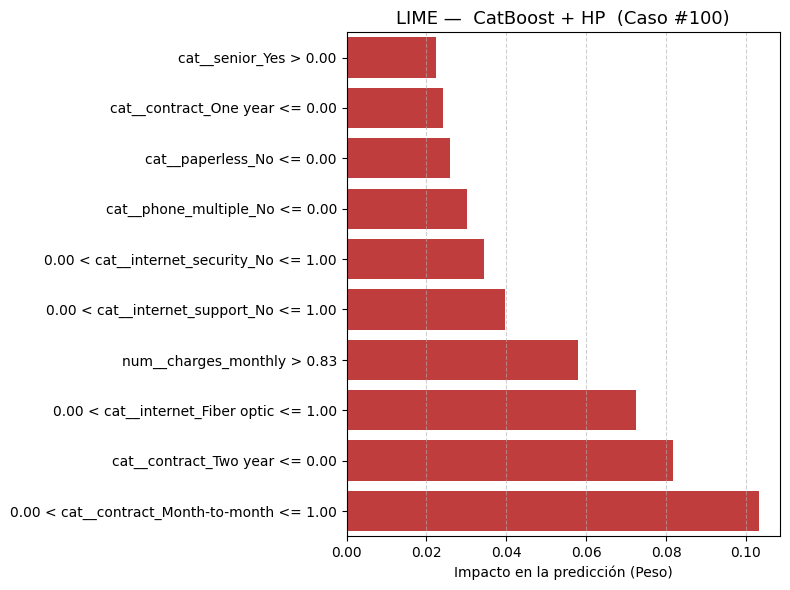

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME —  CatBoost + HP  (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

### **3.3.3 Caso negativo de Churn (i=500)**

Para esta seccion, vamos a ver como se compara este modelo con el registro #500 del dataset estudiado, y ver como se comparan los modelos y sus feature importances.

In [ ]:
preprocessor = cat_final.named_steps["preprocessor"]
classifier = cat_final.named_steps["clf"]

X_train_trans = preprocessor.transform(X_train)
X_test_trans = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()

explainer = LimeTabularExplainer(
    training_data=np.array(X_train_trans),
    feature_names=feature_names,
    class_names=["No Churn", "Sí Churn"],
    mode="classification"
)

In [ ]:
i = 500

exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=classifier.predict_proba,
    num_features=10
)

pred_proba = classifier.predict_proba([X_test_trans[i]])[0]
pred_class = np.argmax(pred_proba)

lime_features = exp.as_list()
df_lime = pd.DataFrame(lime_features, columns=["Característica", "Peso"])
df_lime["abs_peso"] = df_lime["Peso"].abs()
df_lime = df_lime.sort_values(by="abs_peso", ascending=False).reset_index(drop=True)

print("=" * 80)
print(f"Interpretación LIME — Caso #{i}")
print("-" * 80)
print(f"Clase predicha: {'Sí Churn ' if pred_class == 1 else 'No Churn '}")
print(f"Probabilidades -> No: {pred_proba[0]:.3f} | Sí: {pred_proba[1]:.3f}")
print("\nTop 10 características más influyentes:")
print(df_lime[["Característica", "Peso"]].to_string(index=False))
print("=" * 80)


Interpretación LIME — Caso #500
--------------------------------------------------------------------------------
Clase predicha: No Churn 
Probabilidades -> No: 0.979 | Sí: 0.021

Top 10 características más influyentes:
                      Característica      Peso
                  num__tenure > 0.92 -0.145482
cat__contract_Month-to-month <= 0.00 -0.105621
   cat__internet_Fiber optic <= 0.00 -0.074210
       cat__contract_Two year > 0.00 -0.072053
       num__charges_monthly <= -0.97 -0.044454
    cat__internet_support_No <= 0.00 -0.037209
      cat__contract_One year <= 0.00  0.031873
   cat__internet_security_No <= 0.00 -0.031306
      cat__phone_multiple_No <= 0.00  0.027877
           cat__internet_DSL <= 0.00  0.024821


In [ ]:
i = 500
exp = explainer.explain_instance(
    data_row=X_test_trans[i],
    predict_fn=xgb_model.predict_proba,
    num_features=10
)

exp.show_in_notebook(show_table=True)

C:\Users\taran\AppData\Local\Temp\ipykernel_19104\2794980300.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


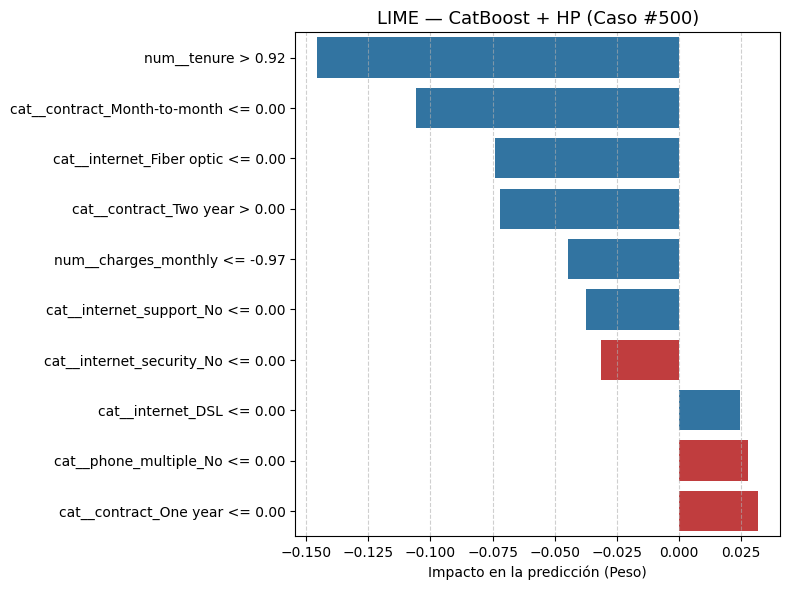

In [ ]:
plt.figure(figsize=(8, 6))
colors = ["#d62728" if w > 0 else "#1f77b4" for w in df_lime["Peso"]]

sns.barplot(
    data=df_lime.sort_values(by="Peso", ascending=True),
    x="Peso",
    y="Característica",
    palette=colors
)

plt.title(f"LIME — CatBoost + HP (Caso #{i})", fontsize=13)
plt.xlabel("Impacto en la predicción (Peso)")
plt.ylabel("")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

## **3.5 Comparacion final entre modelos**

In [ ]:
models = {
    "XGBoost + HP": pipe_xgb,
    "LightGBM + HP + is_unbalanced=True (GPU)": pipe_lgb,
    "RandomForest + HP + SMOTE (GPU)": pipe_rf,
    "CatBoost + HP": pipe_cat
}

feature_orig = X_train.columns


In [ ]:
models_fitted = {
    "XGBoost + HP": grid_xgb.best_estimator_,
    "LightGBM + HP + is_unbalanced=True (GPU)": grid_lgb.best_estimator_,
    "RandomForest + HP + SMOTE (GPU)": grid_rf.best_estimator_,
    "CatBoost + HP": grid_cat.best_estimator_
}


In [ ]:
feature_importances = {}

for name, pipe in models_fitted.items():
    feature_names = pipe.named_steps["preprocessor"].get_feature_names_out()
    clf = pipe.named_steps["clf"]

    if hasattr(clf, "feature_importances_"):
        importances = clf.feature_importances_
    elif "CatBoost" in name:
        importances = clf.get_feature_importance()
    else:
        importances = np.zeros(len(feature_names))

    df_imp = pd.DataFrame({
        "Feature": feature_names,
        "Importance": importances
    }).sort_values("Importance", ascending=False).reset_index(drop=True)

    feature_importances[name] = df_imp


C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3630990556.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3630990556.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3630990556.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
C:\Users\taran\AppData\Local\Temp\ipykernel_19104\3630990556.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` 

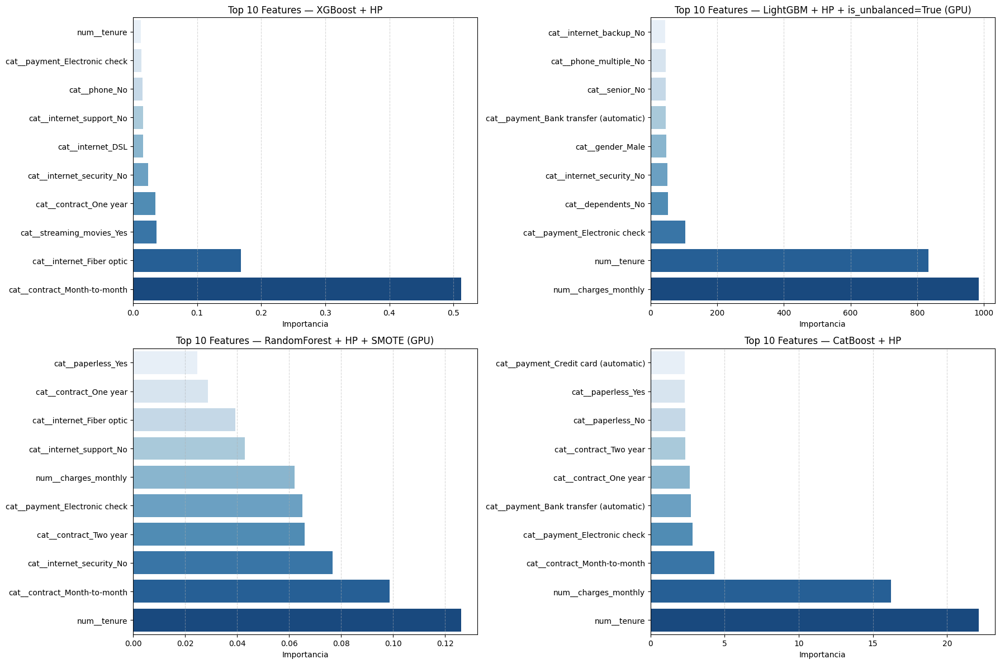

In [ ]:

plt.figure(figsize=(18, 12))
for i, (name, df_imp) in enumerate(feature_importances.items(), 1):
    plt.subplot(2, 2, i)
    top10 = df_imp.head(10)
    sns.barplot(
        data=top10.sort_values("Importance", ascending=True),
        x="Importance",
        y="Feature",
        palette="Blues"
    )
    plt.title(f"Top 10 Features — {name}", fontsize=12)
    plt.xlabel("Importancia")
    plt.ylabel("")
    plt.grid(axis="x", linestyle="--", alpha=0.5)

plt.tight_layout()
plt.show()


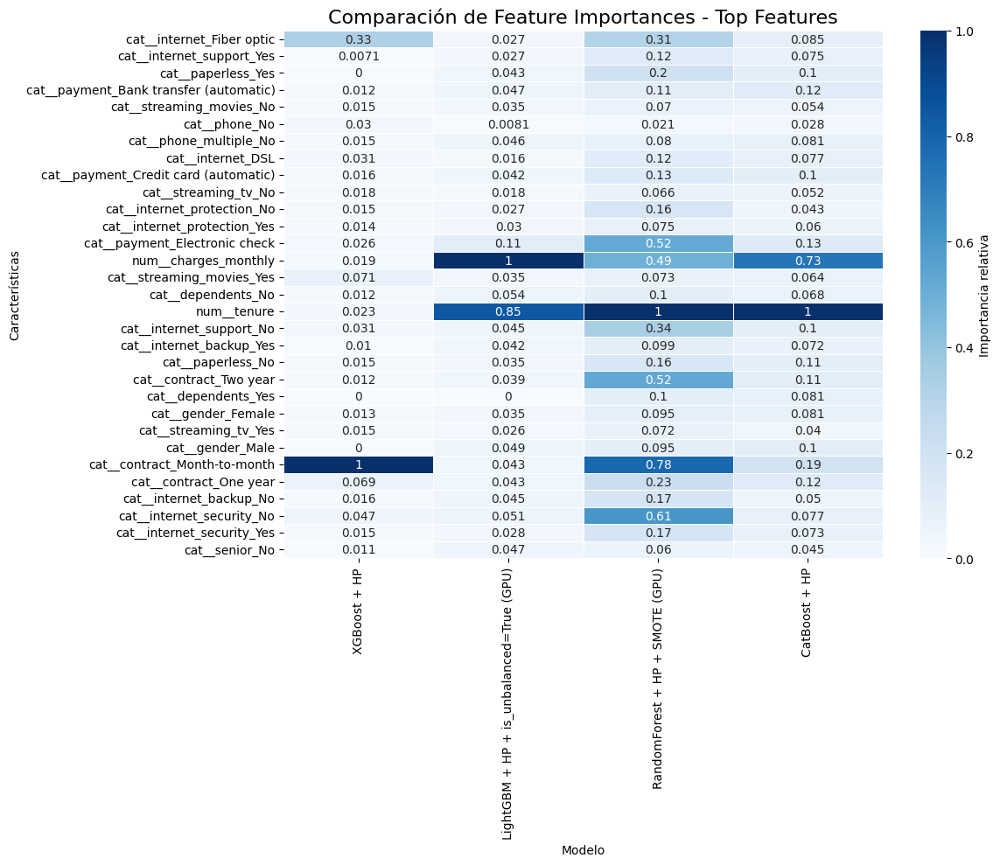

In [ ]:
top_n = 21  
all_features = set()

for df in feature_importances.values():
    all_features.update(df.head(top_n)["Feature"].tolist())

all_features = list(all_features)

heatmap_df = pd.DataFrame(index=all_features)

for name, df in feature_importances.items():
    temp = df.set_index("Feature")["Importance"]
    heatmap_df[name] = temp

heatmap_df = heatmap_df.fillna(0)

heatmap_norm = heatmap_df / heatmap_df.max()

plt.figure(figsize=(12, 10))
sns.heatmap(
    heatmap_norm, 
    annot=True, 
    cmap="Blues", 
    cbar_kws={'label': 'Importancia relativa'}, 
    linewidths=0.5
)
plt.title("Comparación de Feature Importances - Top Features", fontsize=16)
plt.ylabel("Características")
plt.xlabel("Modelo")
plt.tight_layout()
plt.show()
